In [1]:
%load_ext autoreload
%autoreload 2

In [ ]:
#samtools view -h /media/jarbona/jm_data/natalyia/20250220_N_Petryk/output_DNAscent_Run1_20250121_sorted.bam | head -n 10000 | samtools view -b -o test_data/first_10000_reads_DNAscent_v4.bam

In [10]:
from bam_tool_rep.bam_tools import load_read_bam_multi
bam = "./test_data/first_1000_reads_DNAscent_v4.bam"
remove_read_shorter_than=5_000 # in kb
maximum_of_read_processed=None
lower_mean_brdu_threshold=0.05 # remove reads whom medial brdu content are lower that this value
r = load_read_bam_multi(bam,res=100,remove_less_than={"b":lower_mean_brdu_threshold},
                        remove_shorter_than=remove_read_shorter_than,
                        maxi=maximum_of_read_processed,threads=3)
# r is a dictionnary where each item is a read_id / processed read
# r[k][1]["b"] contain the binned read, where k in a k
# r[k][0] contain information about sequence chromosomes and so on

Processing reads: 0it [00:00, ?it/s]/home/jarbona/bam_tool_rep/src/bam_tool_rep/bam_tools.py:291: RuntimeWarning: Mean of empty slice
  val= np.nanmean(val,axis=1,dtype=np.float16)
/home/jarbona/bam_tool_rep/src/bam_tool_rep/bam_tools.py:291: RuntimeWarning: Mean of empty slice
  val= np.nanmean(val,axis=1,dtype=np.float16)
/home/jarbona/bam_tool_rep/src/bam_tool_rep/bam_tools.py:291: RuntimeWarning: Mean of empty slice
  val= np.nanmean(val,axis=1,dtype=np.float16)
Processing reads: 9932it [00:13, 738.08it/s]


In [11]:
import pylab as plt
import numpy as np
import os
from repnano.features.bam_tools import smooth

def create_image(slice_key,ibatch):

    fig,axes = plt.subplots(n_line,by_line,figsize=(15,n_line*1.5))
    i=0
    nk=0
    for k in slice_key:
        nk+=1
        b = r[k][1]["b"]
        if np.max(b)>mininimal_maximum_brdu_value:
            l = np.arange(len(b))/10.
            axes[i//by_line,i%by_line].plot(l,smooth(b,10),"-")
            axes[i//by_line,i%by_line].plot(l,smooth(r[k][1]["e"],10),"-")
            axes[i//by_line,i%by_line].set_ylim(0,1)

            if i//by_line == n_line -1:
                axes[i//by_line,i%by_line].set_xlabel("kb")

            i+=1
        if i == n_line*by_line:
            break

    fig.tight_layout()
    plt.savefig(f"{output_dir}/batch_{ibatch}.pdf")
    return nk

# only put in pdf the first 100 interesting read

274

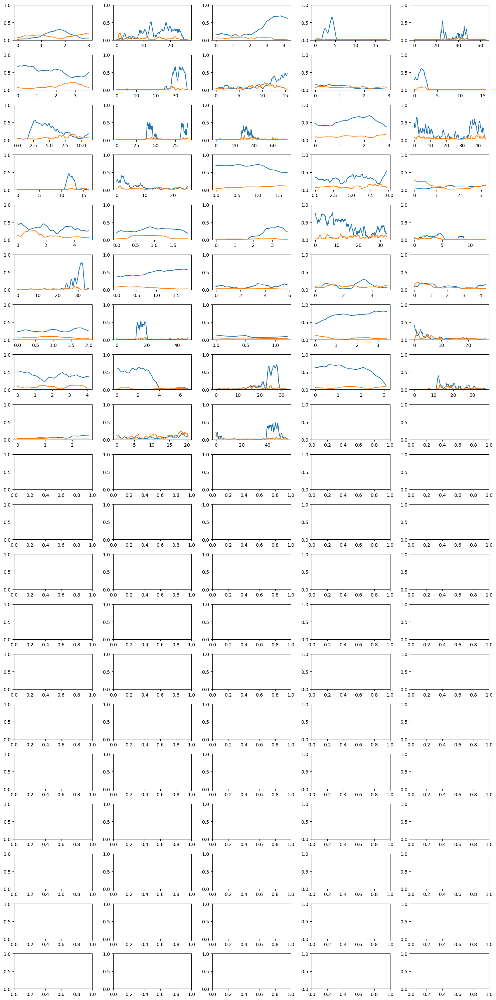

In [12]:
mininimal_maximum_brdu_value = 0.4
by_line = 5
n_line = 20
output_dir="images"
os.makedirs(output_dir,exist_ok=True)

f1=list(r.keys())
create_image(f1,0)


# or process all the reads

23053
0.03071183793866308
0.055003687155684725
0.07721337786839023
0.10579967900056392
0.13317138767188652
0.17828482193206957
0.20539626079035267
0.2272155467834989
0.2608771092699432
0.284518283954366
0.3050795991844879
0.32763631631457946
0.35648288725979266
0.3891467487962521
0.4176462933240793
0.4379907170433349
0.47113173990370016
0.5112132911117859
0.5512514640176983
0.57554331323472


/home/jarbona/miniconda3/envs/repnano/lib/python3.7/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


0.5924174727801154
0.6085975794907388
0.6255151173383073
0.6427363033010888
0.6580922222704203
0.6717130091528217
0.6832950158330803
0.6950505357220318
0.7069795688196764
0.7221185962781417
0.7585563701036742
0.7730447230295406
0.7897887476684162
0.8354660998568516
0.867609421767232
0.8958053181798464
0.9154123107621568
0.9371882184531297
0.9561445365028413
0.9738428837895284
0.988678263132781
1.0


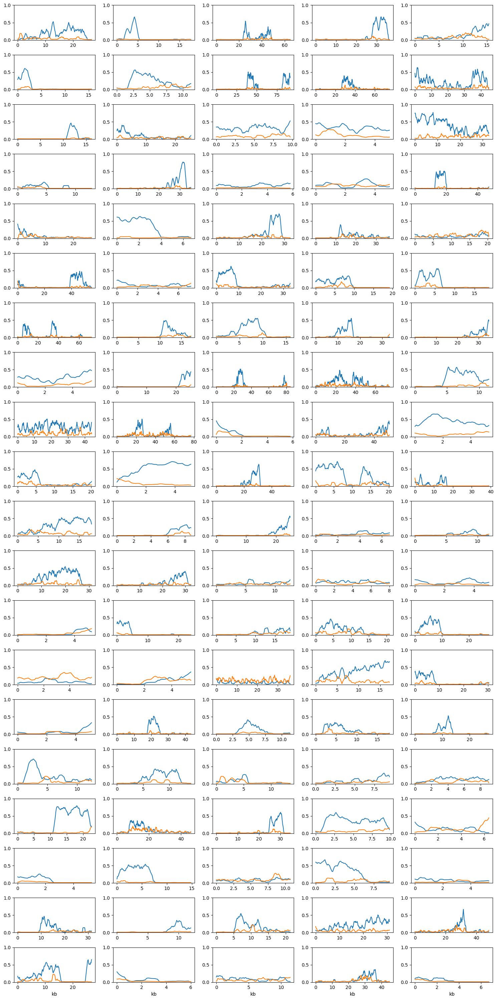

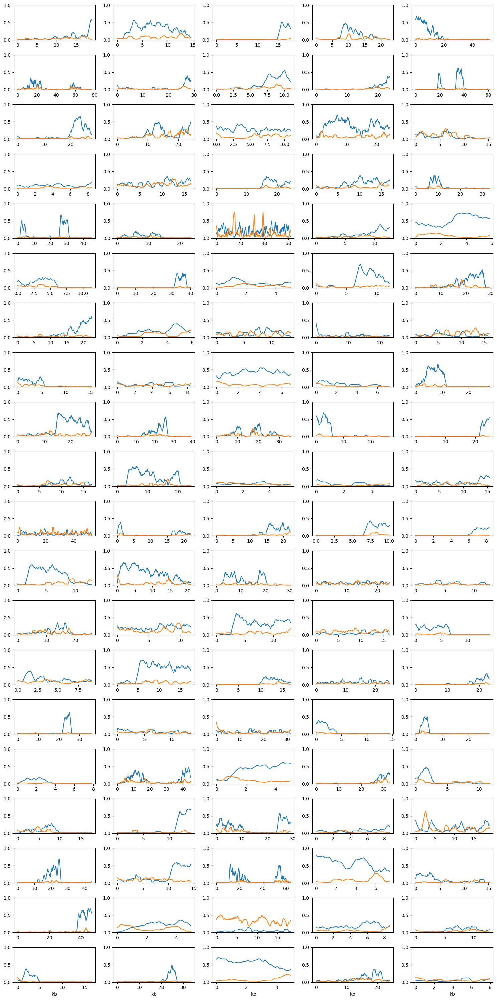

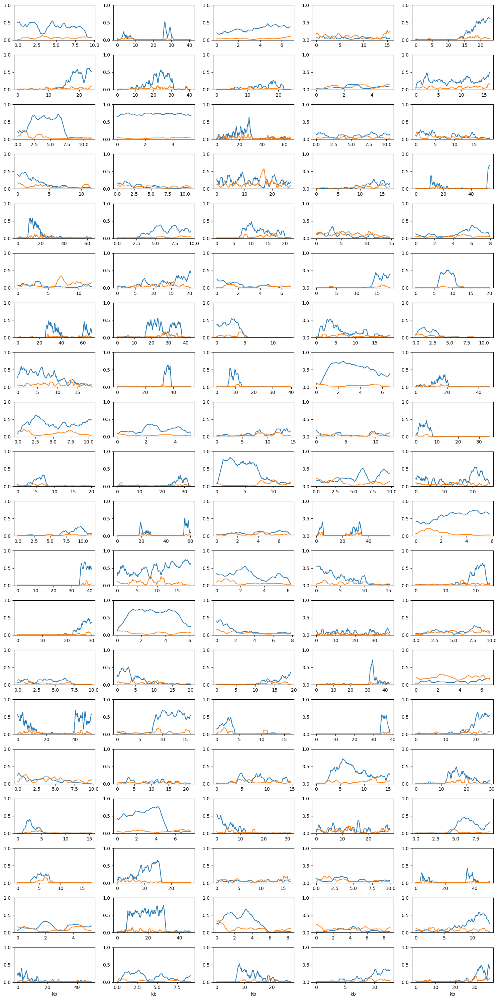

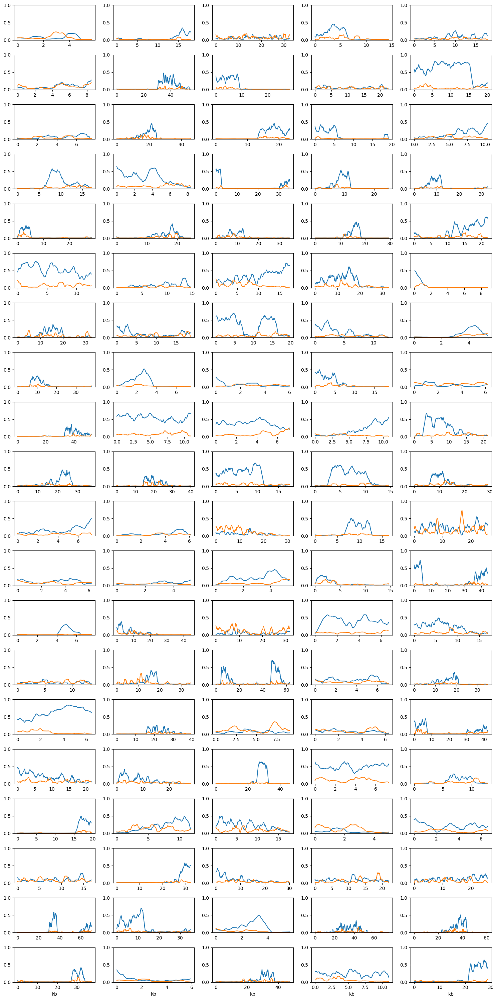

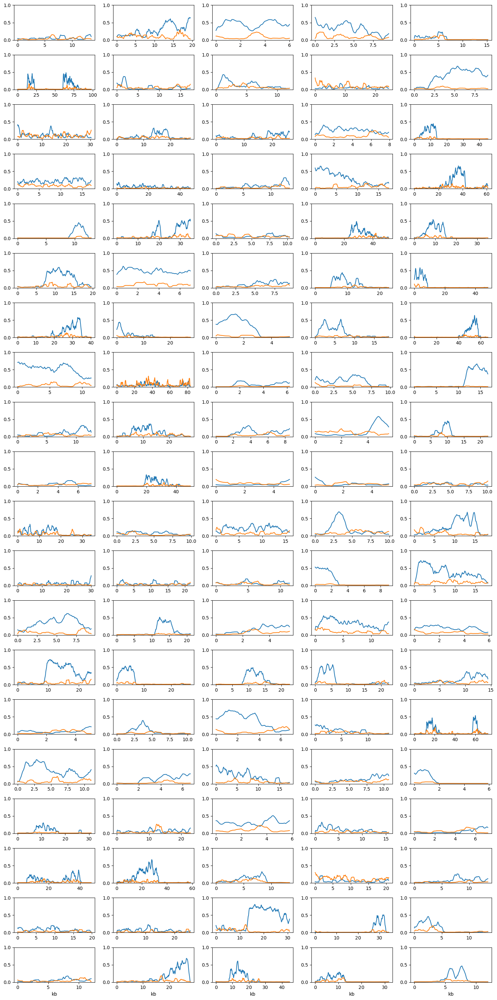

...

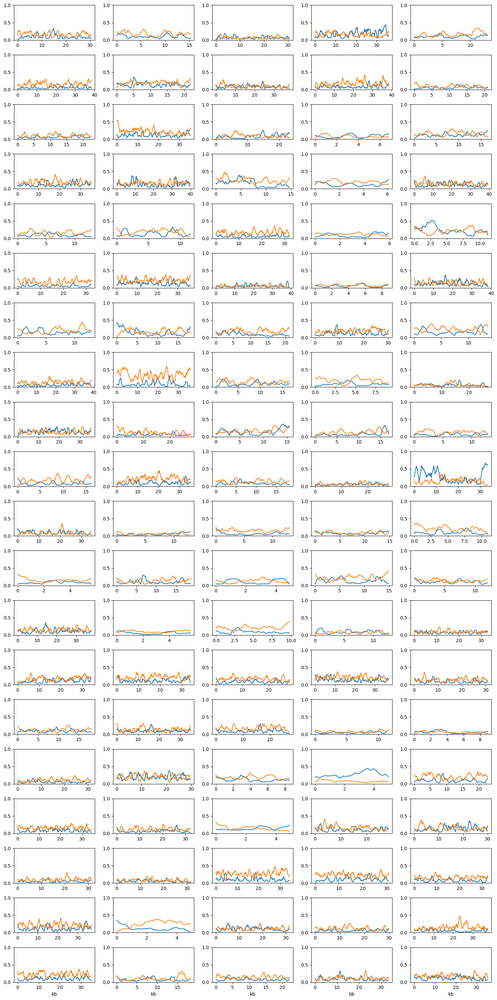

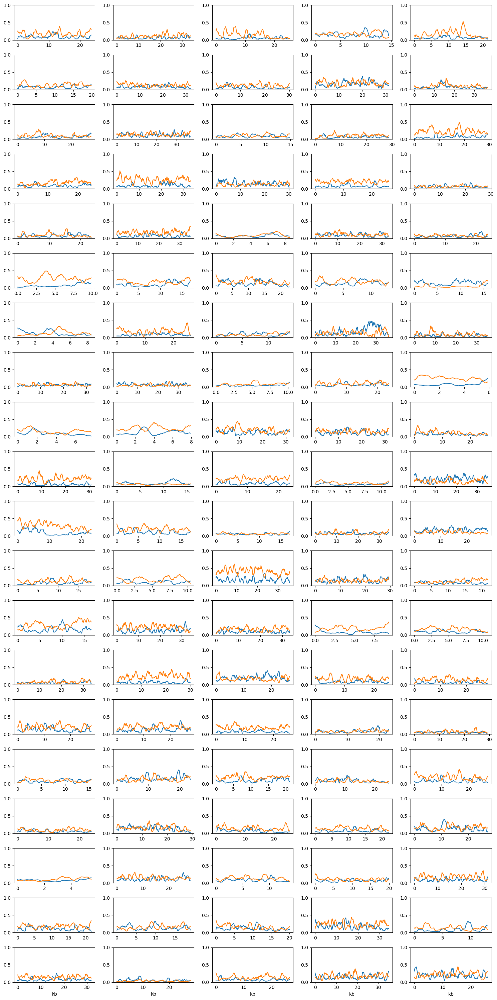

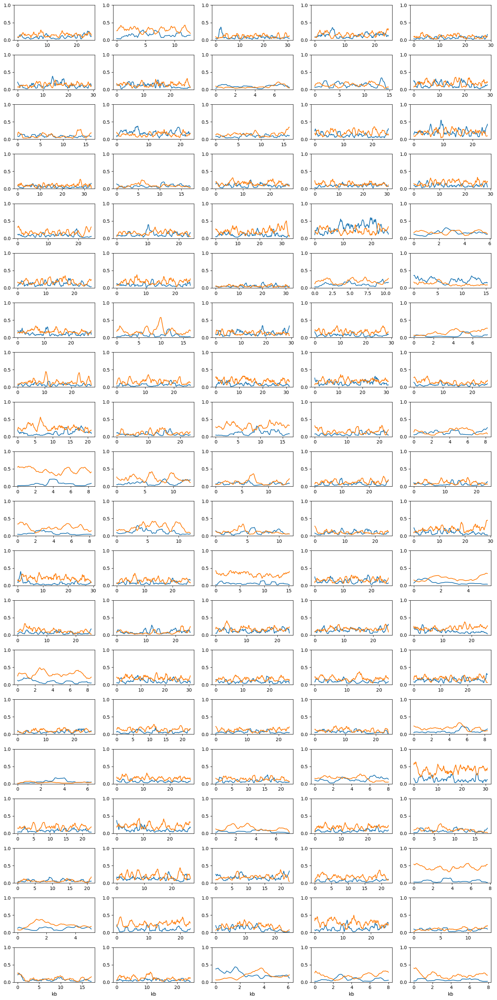

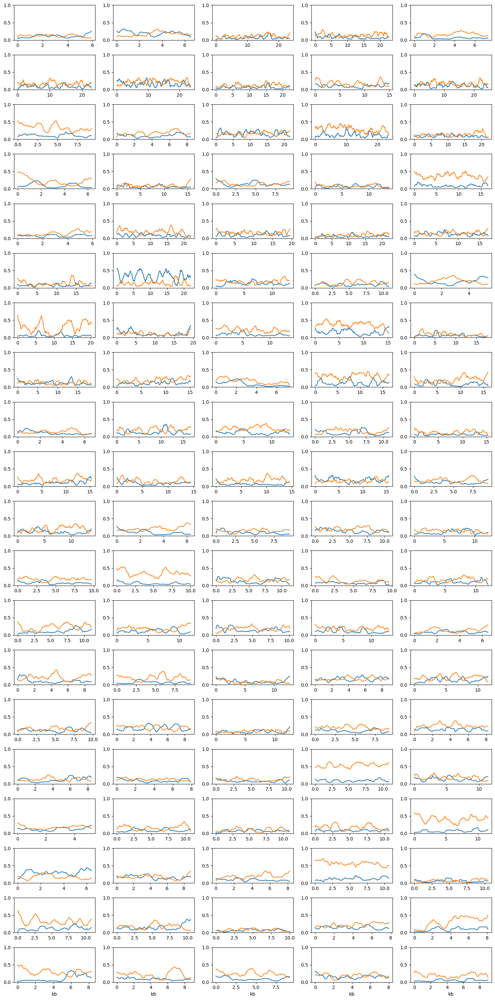

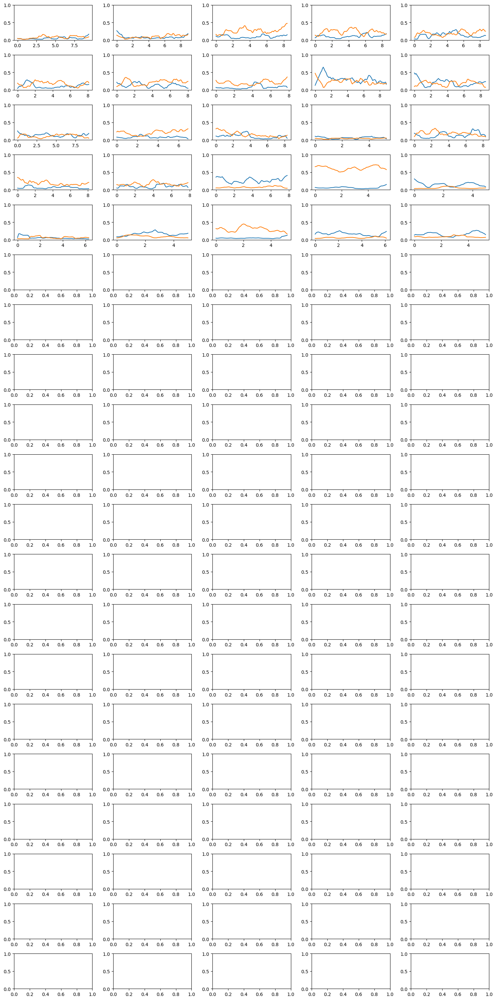

In [102]:

print(len(f1))

ibatch=0
start=0
while True:
    slice_key = f1[start:]
    start += create_image(slice_key,ibatch)
    print(start/len(f1))
    ibatch += 1
    if start >= len(f1) -1:
        break
        
    

In [31]:
r[f1][1]["b"][:20]

array([       nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan,        nan,        nan,
              nan,        nan,        nan, 0.00784314,        nan])